In [ ]:
#default_exp augment.albumentations

# ImageFilter Data Augmentation

> Apply `PIL.ImageFilter`s to your input images

In [ ]:
%load_ext autoreload
%autoreload 2

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'

In [ ]:
#export
try:
    from fastai.vision.all import *
except:
    from fastai2.vision.all import *
import PIL
from typing import List, Tuple, Callable, Union, Optional, Any

In [ ]:
#export
import albumentations as A
from albumentations import (
    RandomBrightness, RandomContrast, CLAHE,      # Lighting Transforms
    ToSepia, ToGray,                              # Color Tones
    RGBShift, HueSaturationValue, ChannelShuffle, # Color Channels
    Blur, MotionBlur, GaussianBlur,               # Blurs
    MedianBlur, IAAEmboss,                        # Style Transfer-Esque
    GaussNoise, IAAAdditiveGaussianNoise,         # Noise
    JpegCompression, Posterize,                   # Noise
    RandomSunFlare,                               # Weather
    FancyPCA,                                     # Other
    OneOf, Compose
)

In [ ]:
files = get_image_files('../assets/imgs')
f1    = files[0]
f2    = files[1]
img1  = PIL.Image.open(f1).resize((500,300))
img2  = PIL.Image.open(f2).resize((500,300))

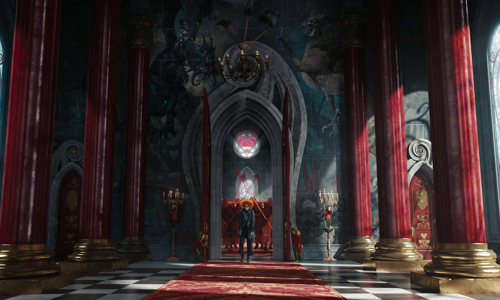

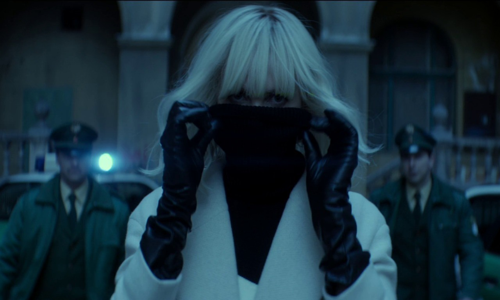

In [ ]:
img1
img2

In [ ]:
to_img  = lambda x:   PILImage.create(x)
as_arr  = lambda x:   np.array(x)
aug     = lambda op,img: op(image=as_arr(img))['image']
aug_img = lambda op,img: to_img(aug(op,img))
side_by_side = lambda arr1,arr2: np.hstack((arr1,arr2))
compare = lambda op,img: PIL.Image.fromarray(side_by_side(img, aug(op,img)))

def compose_augs(augs:list, img:PIL.Image.Image):
    if not isinstance(augs, list): augs=[augs]
    for aug in augs:
        img = aug_img(aug,img)
    return img

### Blurring Transforms

One Of
* Blur
* MotionBlur

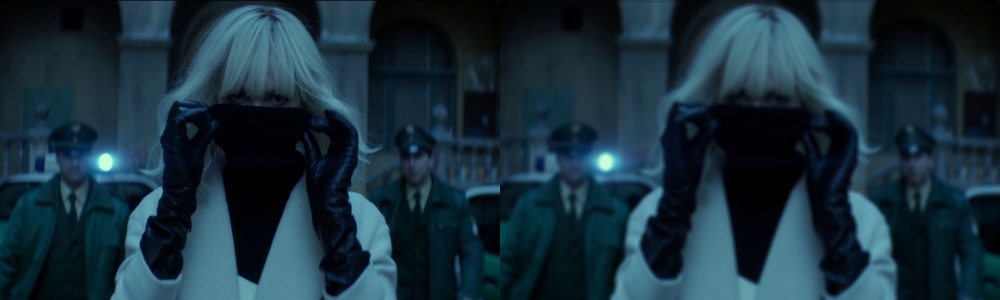

In [ ]:
blur = Blur(always_apply=True)

compare(blur, img2)

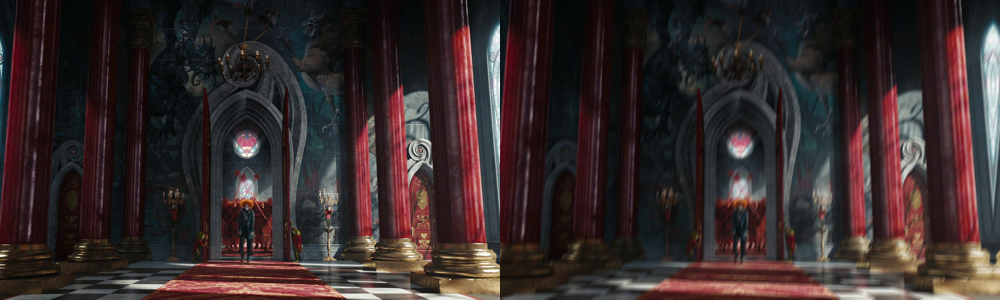

In [ ]:
motion_blur = MotionBlur(blur_limit=(15,15), always_apply=True)
compare(motion_blur, img1)

### Style Transfer-Esque

* MedianBlur
* IAAAEmboss

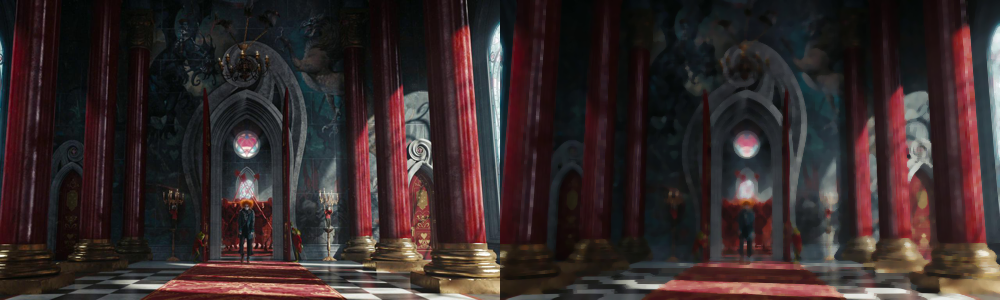

In [ ]:
median_blur = MedianBlur(blur_limit=(3,7), always_apply=True)
compare(median_blur, img1)

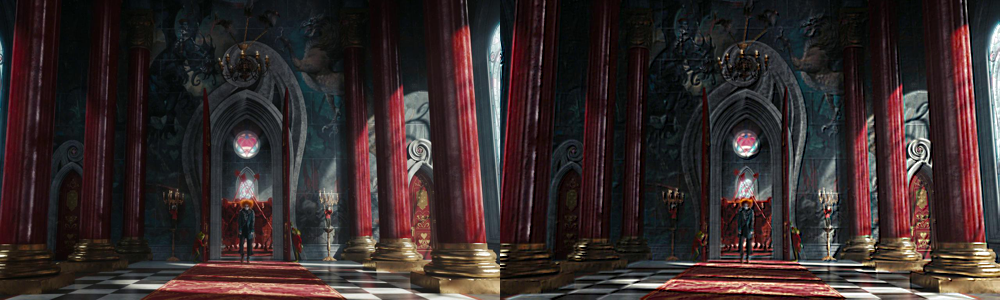

In [ ]:
emboss = IAAEmboss(strength=(0.2,0.99), always_apply=True)
compare(emboss, img1)

### Other

* FancyPCA

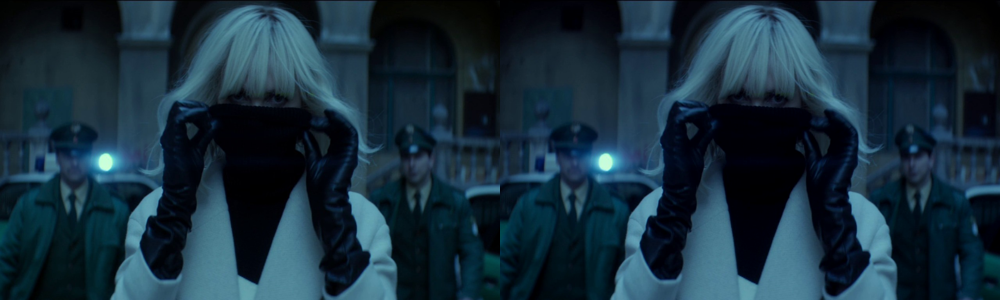

In [ ]:
pca = FancyPCA(0.3, always_apply=True)
compare(pca, img2)

### Color Tones

* Solarize
* ToGray
* Sepia

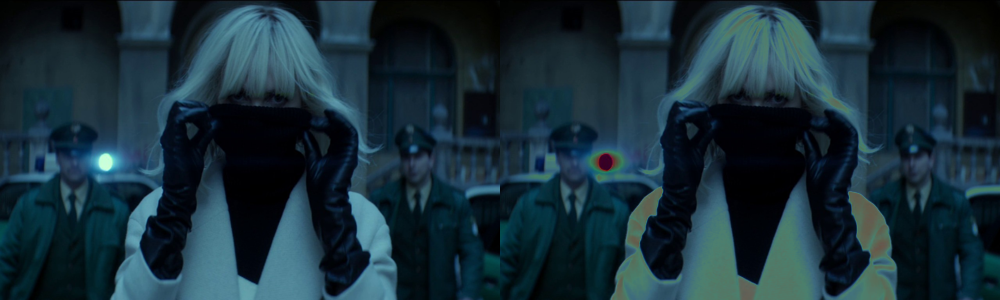

In [ ]:
#nope
solarize = A.Solarize(always_apply=True)
compare(solarize, img2)

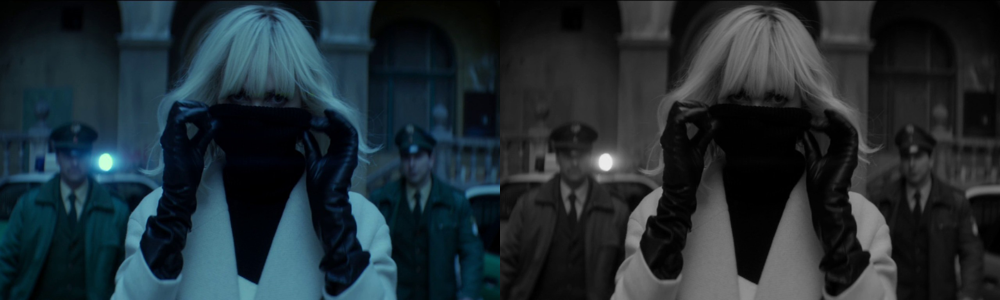

In [ ]:
gray = ToGray(always_apply=True)
compare(gray, img2)

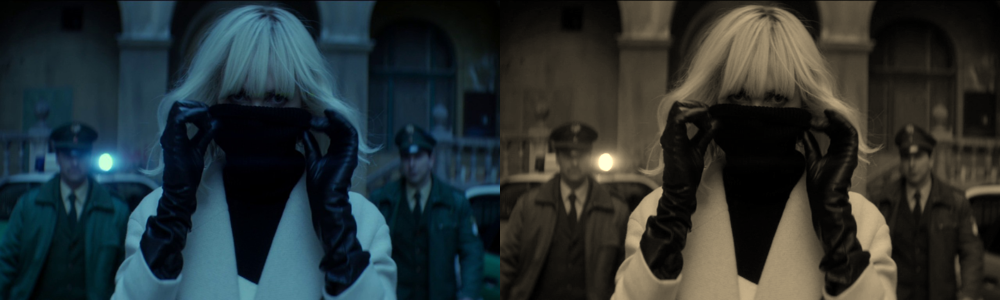

In [ ]:
sepia = ToSepia(always_apply=True)
compare(sepia, img2)

### Noise


One of:
* IAAAAdditiveGaussianNoise
* GaussNoise

* JpegCompress

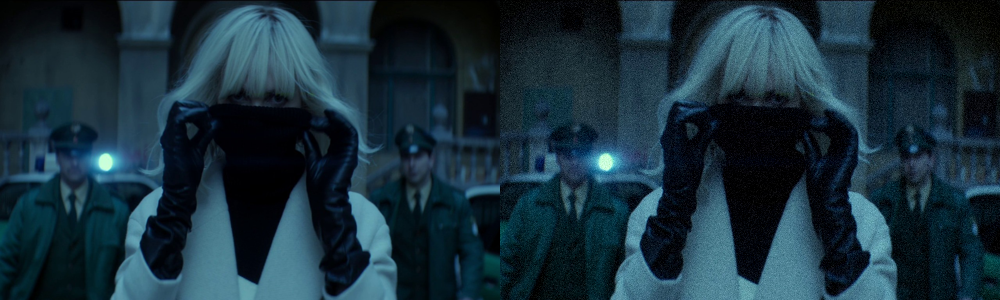

In [ ]:
tfm = IAAAdditiveGaussianNoise(always_apply=True)
compare(tfm, img2)

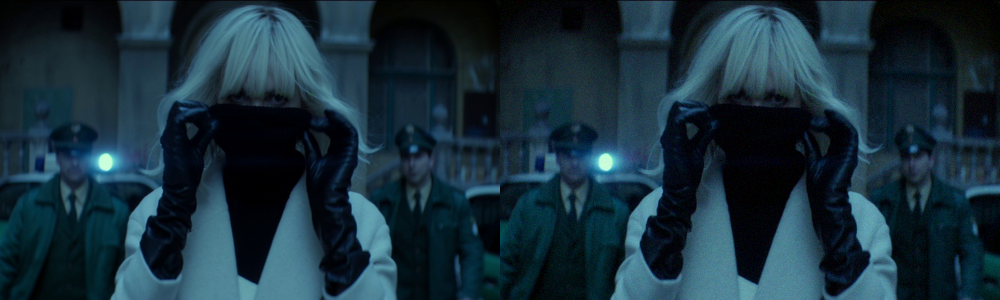

In [ ]:
gauss_noise = GaussNoise(always_apply=True)
compare(gauss_noise, img2)

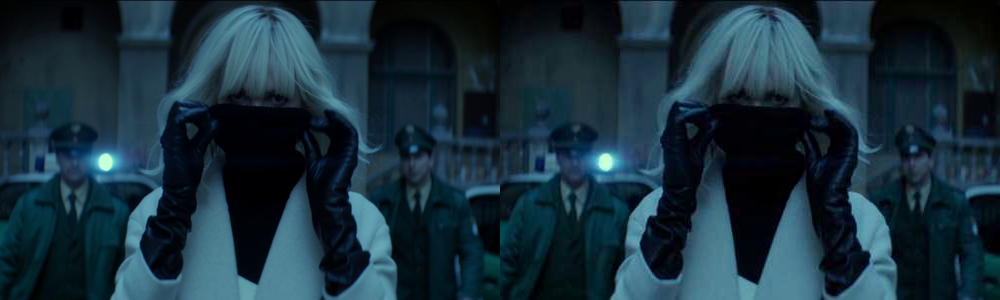

In [ ]:
jpeg_compress = JpegCompression(quality_lower=25, quality_upper=55, always_apply=True)
compare(jpeg_compress, img2)

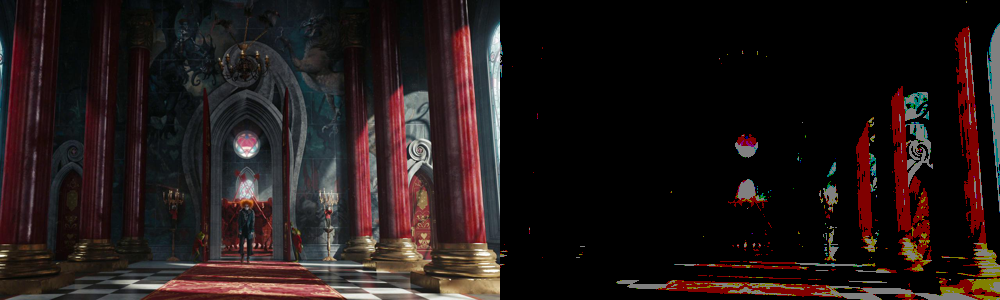

In [ ]:
#nope
posterize = Posterize(True)
compare(posterize, img1)

### Weather Transforms

* Sun Flare

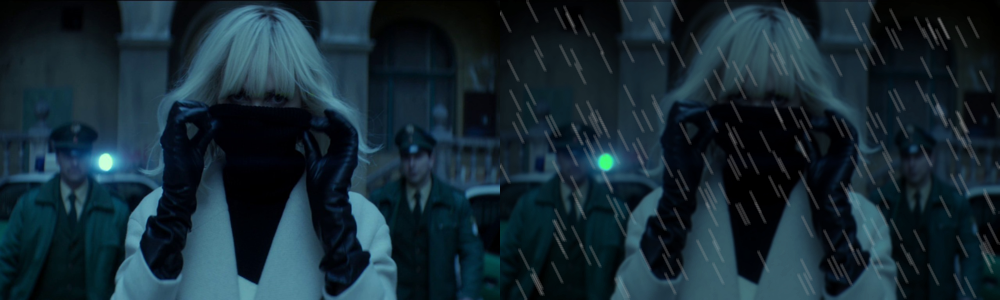

In [ ]:
rain = A.RandomRain(always_apply=True, blur_value=3)
compare(rain, img2)

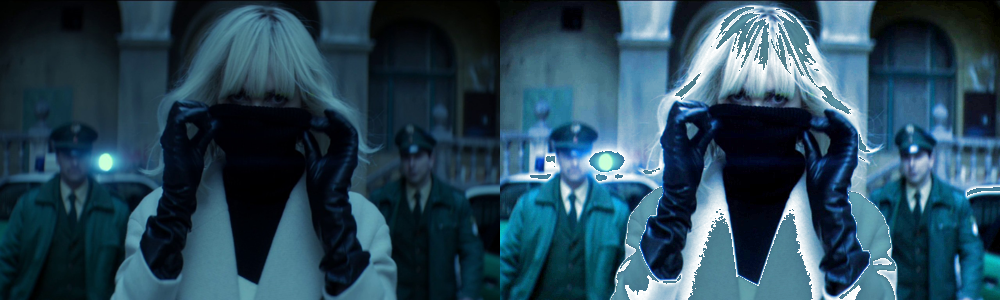

In [ ]:
snow = A.RandomSnow(always_apply=True)
compare(snow, img2)

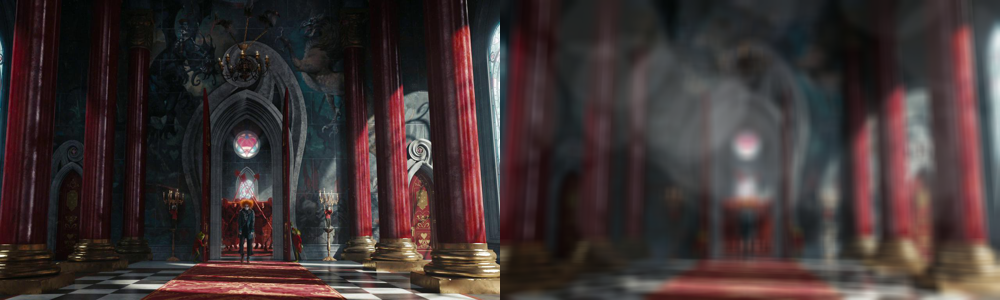

In [ ]:
#nope
fog = A.RandomFog(always_apply=True)
compare(fog, img1)

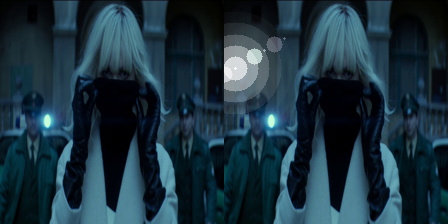

In [ ]:
sun_flare = RandomSunFlare(always_apply=True, src_radius=80)
compare(sun_flare, img2.resize((224,224)))

### Lighting Transforms

* RandomContrast
* RandomBrightness
* CLAHE

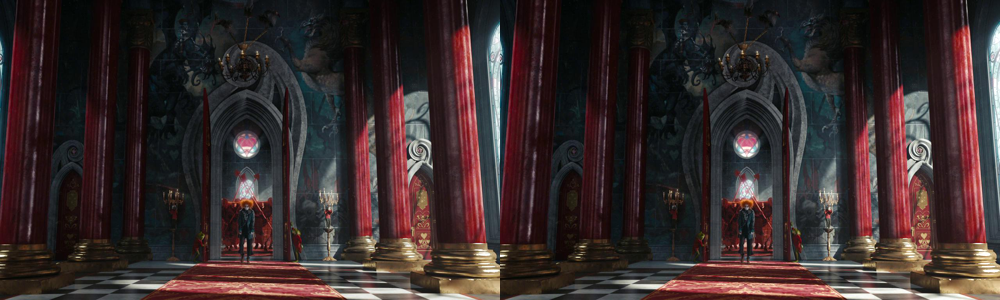

In [ ]:
random_contrast = RandomContrast(always_apply=True)
compare(random_contrast, img1)

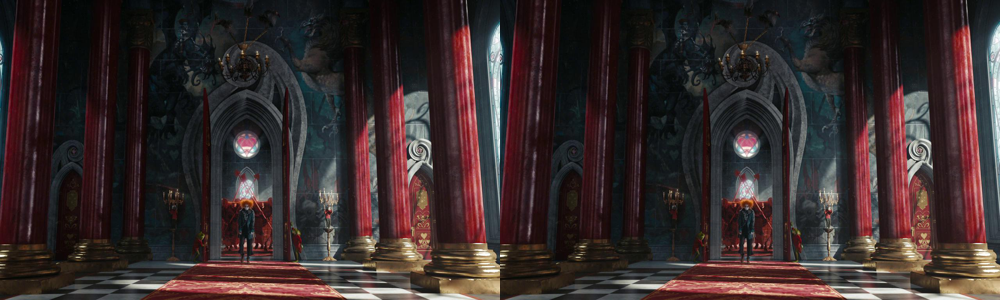

In [ ]:
random_brightness = RandomBrightness(0.05, always_apply=True)
compare(random_brightness, img1)

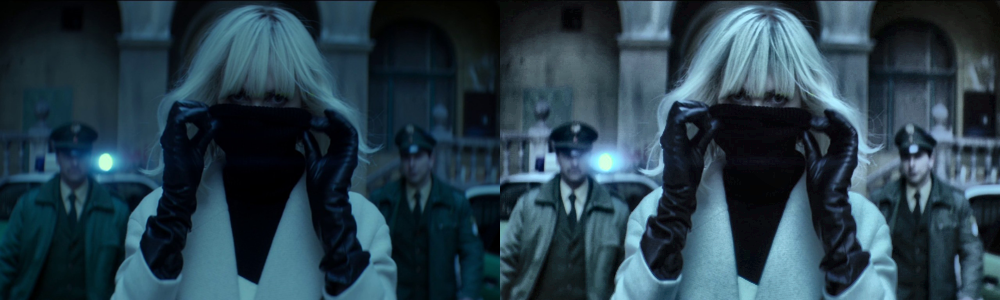

In [ ]:
clahe = CLAHE(always_apply=True)
compare(clahe, img2)

### Channel Level Transforms

* ChannelShuffle
* HueSaturationValue
* RGBShift

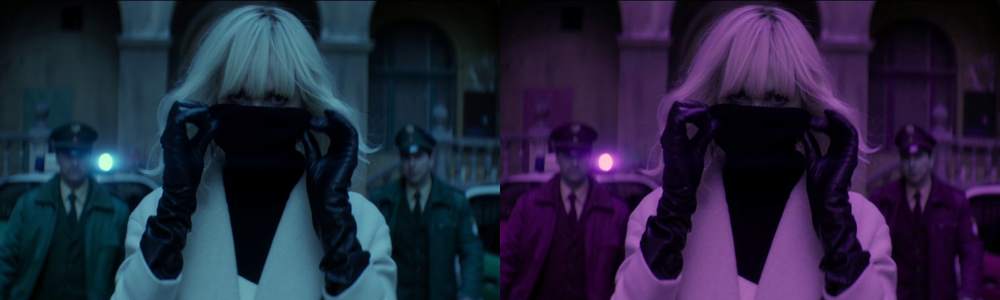

In [ ]:
channel_shuffle = ChannelShuffle(always_apply=True)
compare(channel_shuffle,img2)

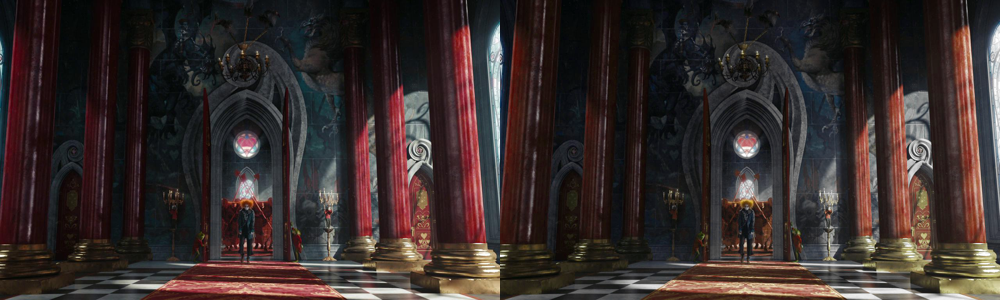

In [ ]:
hsv = HueSaturationValue(val_shift_limit=10)
compare(hsv, img1)

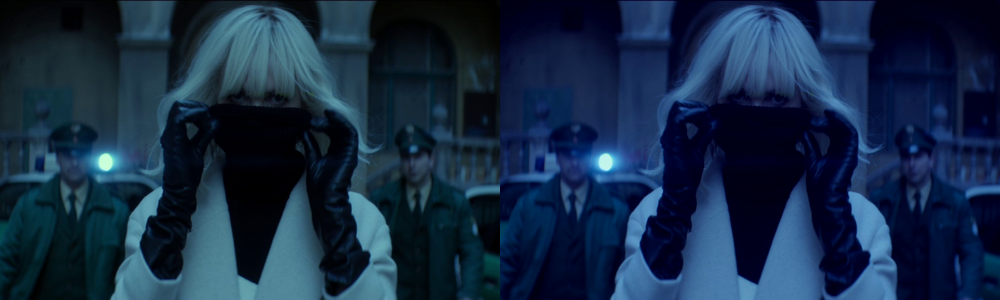

In [ ]:
rgb_shift = RGBShift(always_apply=True)
compare(rgb_shift, img2)

### Merging With FastAI

In [ ]:
#export
def albu_augment(aug, img): return aug(image=np.array(img))['image']

##https://dev.fast.ai/tutorial.pets
class AlbumentationsWrapper(Transform):
    "Wrapper function for any Albumentations Transform"
    order=0 # apply before `ToTensor`
    def __init__(self, aug): self.aug=aug
    def __repr__(self): return self.aug.__repr__()

    def _encodes(self, img:PILImage):
        aug_img = albu_augment(self.aug, img)
        return PILImage.create(aug_img)

    def encodes(self, img:PIL.Image.Image): return self._encodes(img)
    def encodes(self, img:PILImage): return self._encodes(img)
    def encodes(self, o:(str,Path)): return self._encodes(PILImage.create(o))

In [ ]:
#hide
from nbdev.showdoc import *

### Formulate Different Transform Blocks

The transforms below are segregated into 8 different blocks:
* Blurring
* Style
* Weather
* Noise
* ColorTones
* ColorChannel
* Lighting
* Other

`HueSaturationValue` has a low `val_shift_limit` to 
minimise lighting change, as that will come from other
lighting transforms

In [ ]:
#export

# lean heavily towards Motion Blur
BlurringTfms = OneOf([
    MotionBlur(blur_limit=(15,15), p=0.8),
    Blur(p=0.2)
], p=0.5)

StyleTfms = OneOf([
    MedianBlur(blur_limit=(3,7), p=0.6),
    IAAEmboss(strength=(0.2,0.99), p=0.4)
], p=0.3)

WeatherTfms = RandomSunFlare(
    src_radius=80, p=0.1
)

NoiseTfms = OneOf([
    GaussNoise(p=0.6),
    IAAAdditiveGaussianNoise(p=0.4), # stronger
    JpegCompression(quality_lower=25, quality_upper=55, p=0.2)
], p=0.25)

ColorTonesTfms = OneOf([
    ToSepia(),
    ToGray()
], p=0.3)

ColorChannelTfms = OneOf([
    ChannelShuffle(),
    HueSaturationValue(val_shift_limit=5),
    RGBShift()
], p=0.3)

LightingTfms = OneOf([
    RandomContrast(p=0.1),
    RandomBrightness(p=0.1),
    CLAHE(p=0.8)
], p=0.3)

OtherTfms = FancyPCA(alpha=0.4, p=0.4)

In [ ]:
#export
Tfms = Compose([
    BlurringTfms,
    StyleTfms,
    WeatherTfms,
    NoiseTfms,
    ColorTonesTfms,
    ColorChannelTfms,
    LightingTfms,
    OtherTfms
])

In [ ]:
albu_tfms = AlbumentationsWrapper(Tfms)

In [ ]:
#hide
def collate_arrays(x:Collection):
    arrays = []
    for item in x:
        if isinstance(item, np.ndarray): arrays.append(item)
        else: arrays.append(np.array(item))
    return arrays

hstack = lambda x: PIL.Image.fromarray(np.hstack(x))
vstack = lambda x: PIL.Image.fromarray(np.vstack(x))

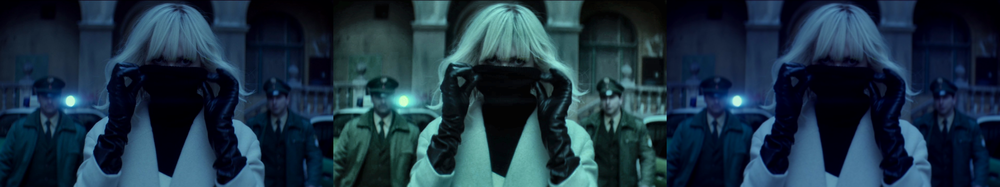

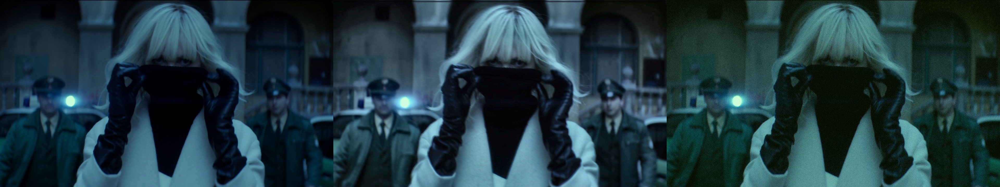

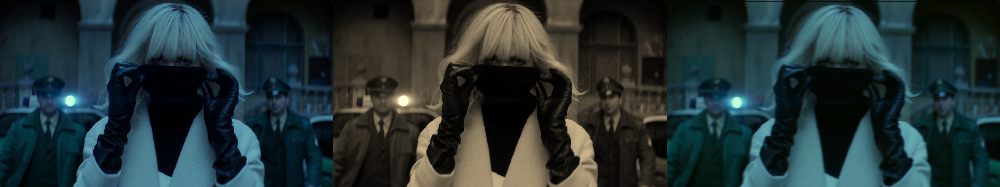

In [ ]:
hstack([albu_tfms(f2), albu_tfms(f2), albu_tfms(f2)])
hstack([albu_tfms(f2), albu_tfms(f2), albu_tfms(f2)])
hstack([albu_tfms(f2), albu_tfms(f2), albu_tfms(f2)])

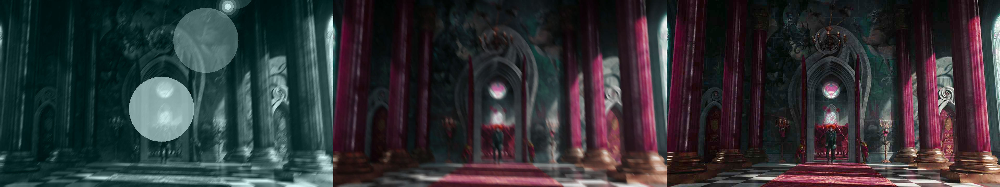

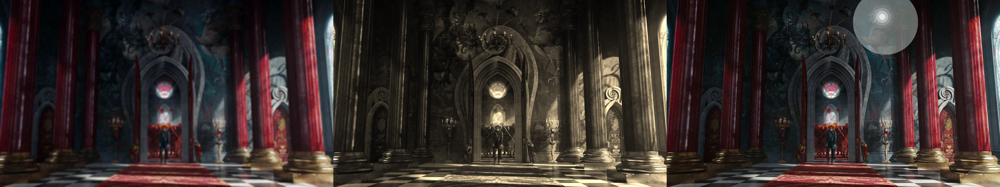

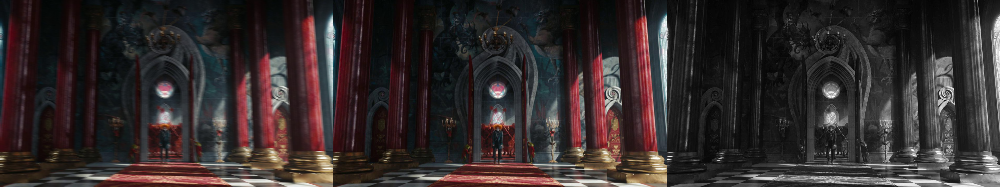

In [ ]:
f2 = f1
hstack([albu_tfms(f2), albu_tfms(f2), albu_tfms(f2)])
hstack([albu_tfms(f2), albu_tfms(f2), albu_tfms(f2)])
hstack([albu_tfms(f2), albu_tfms(f2), albu_tfms(f2)])

In [ ]:
dblock = DataBlock(
    blocks     = (ImageBlock, CategoryBlock),
    get_items  = get_image_files,
    get_x      = Pipeline([PILImage.create, albu_tfms]),
    get_y      = parent_label,
    splitter   = RandomSplitter(seed=42, valid_pct=0.),
    item_tfms  = [Resize(size=224, method=ResizeMethod.Squish, pad_mode=PadMode.Zeros)],
    batch_tfms = [Normalize.from_stats(*imagenet_stats)]
)

In [ ]:
dls = dblock.dataloaders('../assets/imgs', bs=3)

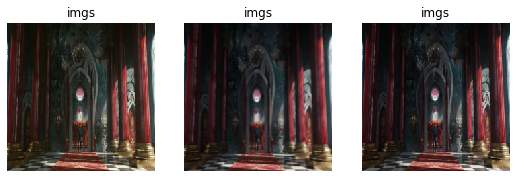

In [ ]:
dls.show_batch(unique=True)

### Export

In [ ]:
from nbdev.export import notebook2script

In [ ]:
notebook2script('06_augment_albumentations.ipynb')

Converted 06_augment_albumentations.ipynb.
